In [1]:
pip install prophet

In [2]:
# Python
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import numpy as np
from prophet.plot import plot_plotly, plot_components_plotly
import plotly.graph_objs as go
import plotly.express as px
import seaborn as sns

## Group 3 RT.csv

In [3]:
# Python
df = pd.read_csv('C:/Users/thoma/OneDrive - BCIT/Hackathon Kick-Off!/Question 3_ Building Efficiency and Health/Sensor Readings/Group 3 RT.csv')
# Python
#df = pd.read_csv('https://raw.githubusercontent.com/facebook/prophet/main/examples/example_wp_log_peyton_manning.csv')
df.head()

,Timestamp,VAV1902_RT_TL,ITBQ10_GRID_FK_B3_RT_POLL_TL,ITBQ10_GRID_FH_B3_RT_POLL_TL
0,2024-03-24 00:00:00,NaN,22.151798,20.863373
1,2024-03-24 00:02:00,21.786522,NaN,NaN
2,2024-03-24 00:05:00,NaN,22.151798,20.863373
3,2024-03-24 00:07:00,21.786522,NaN,NaN
4,2024-03-24 00:10:00,NaN,22.199867,20.863373


In [4]:
print(df.columns)

df.describe()

Index(['Timestamp', 'VAV1902_RT_TL', 'ITBQ10_GRID_FK_B3_RT_POLL_TL',
       'ITBQ10_GRID_FH_B3_RT_POLL_TL'],
      dtype='object')


,VAV1902_RT_TL,ITBQ10_GRID_FK_B3_RT_POLL_TL,ITBQ10_GRID_FH_B3_RT_POLL_TL
count,3006.000000,3016.000000,3016.000000
mean,22.306985,22.333009,20.947823
std,0.538457,0.275116,0.276802
min,21.570204,21.767231,19.709671
25%,21.882664,22.101804,20.767231
50%,22.171089,22.324854,20.959515
75%,22.555656,22.517511,21.151798
max,24.069891,23.305500,21.728649


In [5]:
# Prepare DataFrame for Prophet
df['ds'] = pd.to_datetime(df['Timestamp'])  # Assuming 'Timestamp' is the column containing timestamps
df = df.rename(columns={'VAV1902_RT_TL': 'VAV1902', 'ITBQ10_GRID_FK_B3_RT_POLL_TL': 'ITBQ10_GRID_FK_B3', 'ITBQ10_GRID_FH_B3_RT_POLL_TL': 'ITBQ10_GRID_FH_B3'})  # Rename columns

# Combine non-null values of all three columns into a single column 'y'
df['y'] = df[['VAV1902', 'ITBQ10_GRID_FK_B3', 'ITBQ10_GRID_FH_B3']].max(axis=1)  # Adjust as needed (e.g., median instead of mean)

# Drop rows with NaN values in 'y' column
df = df.dropna(subset=['y'])

# Split data into training and testing sets
train_df, test_df = train_test_split(df, test_size=0.2, shuffle=False)

In [6]:
# Initialize variables to store the best model and its RMSE
best_model = None
best_rmse = np.inf

for _ in range(10):  # Repeat the process 10 times to reduce randomness
    # Initialize Prophet model
    model = Prophet()

    # Fit the model to the training data
    model.fit(train_df)

    # Make predictions on the testing data
    future = model.make_future_dataframe(periods=len(test_df), freq='min')  # Adjust frequency as needed
    #future = model.make_future_dataframe(periods=1, freq='H')  # hourly
    #future = model.make_future_dataframe(periods=15, freq='min')  # 15 minutes
    #future = model.make_future_dataframe(periods=365)  # Daily
    
    forecast = model.predict(future)

    # Compute RMSE
    y_true = test_df['y'].values
    y_pred = forecast['yhat'].iloc[-len(test_df):].values
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))

    # Update best model and RMSE if necessary
    if rmse < best_rmse:
        best_model = model
        best_rmse = rmse

# Print the best RMSE
print("Best RMSE:", best_rmse)

future.tail()

23:58:20 - cmdstanpy - INFO - Chain [1] start processing
23:58:24 - cmdstanpy - INFO - Chain [1] done processing
23:58:31 - cmdstanpy - INFO - Chain [1] start processing
23:58:35 - cmdstanpy - INFO - Chain [1] done processing
23:58:42 - cmdstanpy - INFO - Chain [1] start processing
23:58:45 - cmdstanpy - INFO - Chain [1] done processing
23:58:49 - cmdstanpy - INFO - Chain [1] start processing
23:58:53 - cmdstanpy - INFO - Chain [1] done processing
23:58:57 - cmdstanpy - INFO - Chain [1] start processing
23:59:00 - cmdstanpy - INFO - Chain [1] done processing
23:59:04 - cmdstanpy - INFO - Chain [1] start processing
23:59:08 - cmdstanpy - INFO - Chain [1] done processing
23:59:11 - cmdstanpy - INFO - Chain [1] start processing
23:59:15 - cmdstanpy - INFO - Chain [1] done processing
23:59:19 - cmdstanpy - INFO - Chain [1] start processing
23:59:22 - cmdstanpy - INFO - Chain [1] done processing
23:59:26 - cmdstanpy - INFO - Chain [1] start processing
23:59:29 - cmdstanpy - INFO - Chain [1]

Best RMSE: 0.5039964446892611


,ds
6017,2024-04-02 04:40:00
6018,2024-04-02 04:41:00
6019,2024-04-02 04:42:00
6020,2024-04-02 04:43:00
6021,2024-04-02 04:44:00


**ds**: The date/time index for the forecast.

**yhat**: The forecasted value.

**yhat_lower** and **yhat_upper**: The lower and upper bounds of the forecast interval.

**trend**: The trend component of the forecast.

**additive_terms**, **daily**, **multiplicative_terms**: Additional components of the forecast, such as holidays, seasonality, etc.

In [7]:
# Make predictions
forecast = best_model.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
6017,2024-04-02 04:40:00,21.838495,21.221227,22.566382
6018,2024-04-02 04:41:00,21.838448,21.213855,22.530663
6019,2024-04-02 04:42:00,21.838414,21.207964,22.540765
6020,2024-04-02 04:43:00,21.838391,21.219573,22.554262
6021,2024-04-02 04:44:00,21.838380,21.194558,22.525713


In [8]:
from prophet.plot import plot_plotly, plot_components_plotly

plot_plotly(best_model, forecast)


In [9]:
plot_components_plotly(best_model, forecast)

In [10]:
# Calculate correlation matrix
correlation_matrix = df[['VAV1902', 'ITBQ10_GRID_FK_B3', 'ITBQ10_GRID_FH_B3']].corr()

# Create heatmap using plotly
heatmap = go.Figure(data=go.Heatmap(
                   z=correlation_matrix.values,
                   x=correlation_matrix.columns,
                   y=correlation_matrix.columns,
                   colorscale='Viridis'))

heatmap.update_layout(
    title='Correlation Heatmap',
    xaxis=dict(title='Columns'),
    yaxis=dict(title='Columns'))

heatmap.show()

## A42_W3327_02.csv

In [11]:
# Python
df2 = pd.read_csv('C:/Users/thoma/OneDrive - BCIT/Hackathon Kick-Off!/Question 3_ Building Efficiency and Health/Sensor Readings/A42_W3327_02.csv')
df2 = df2.rename(columns={'ITB_VAV_A42_W3327_02_RT_AV_TL': 'RoomTemp', 
                        'ITB_VAV_A42_W3327_02_FLW_AV_TL': 'AirFlow', 
                        'ITB_VAV_A42_W3327_02_CO2_TL': 'CO2'})  # Rename columns

df2.head()

,Timestamp,RoomTemp,AirFlow,CO2
0,2024-03-24 00:00:00,21.928248,92.171913,551.886597
1,2024-03-24 00:15:00,21.928248,93.375603,557.747375
2,2024-03-24 00:30:00,21.865717,92.968056,553.840210
3,2024-03-24 00:45:00,21.740641,90.800179,548.366211
4,2024-03-24 01:00:00,21.678095,92.808052,547.963379


In [12]:
# Prepare DataFrame for Prophet
df2['ds'] = pd.to_datetime(df2['Timestamp'])  # Assuming 'Timestamp' is the column containing timestamps

models = {}  # Dictionary to hold Prophet models for each column
for col in ['RoomTemp', 'AirFlow', 'CO2']:
    # Initialize Prophet model
    models[col] = Prophet()

    # Combine non-null values of the current column into a single column 'y'
    df2.dropna(subset=[col], inplace=True)
    df2['y'] = df2[col]  # For Prophet, each column to analyze should be named 'y'

    # Drop rows with NaN values in the current column
    df2.dropna(subset=['y'], inplace=True)

    # Fit the model to the data
    models[col].fit(df2)

    # Create a DataFrame with future dates
    future = models[col].make_future_dataframe(periods=len(df), freq='min')  # hourly
    # future = models[col].make_future_dataframe(periods=15, freq='min')  # 15 minutes
    # future = models[col].make_future_dataframe(periods=365)  # Daily

    # Display the last few rows of the future DataFrame
    print(future.tail())


23:59:50 - cmdstanpy - INFO - Chain [1] start processing
23:59:50 - cmdstanpy - INFO - Chain [1] done processing


                      ds
6689 2024-04-04 04:03:00
6690 2024-04-04 04:04:00
6691 2024-04-04 04:05:00
6692 2024-04-04 04:06:00
6693 2024-04-04 04:07:00


23:59:51 - cmdstanpy - INFO - Chain [1] start processing
23:59:51 - cmdstanpy - INFO - Chain [1] done processing


                      ds
6689 2024-04-04 04:03:00
6690 2024-04-04 04:04:00
6691 2024-04-04 04:05:00
6692 2024-04-04 04:06:00
6693 2024-04-04 04:07:00


23:59:51 - cmdstanpy - INFO - Chain [1] start processing
23:59:52 - cmdstanpy - INFO - Chain [1] done processing


                      ds
6689 2024-04-04 04:03:00
6690 2024-04-04 04:04:00
6691 2024-04-04 04:05:00
6692 2024-04-04 04:06:00
6693 2024-04-04 04:07:00


In [13]:
# Make predictions for each column
forecasts = {}
for col in ['RoomTemp', 'AirFlow', 'CO2']:
    forecasts[col] = models[col].predict(future)

# Show predictions for each column
for col in ['RoomTemp', 'AirFlow', 'CO2']:
    print(f"\n Predictions for {col}:")
    print(forecasts[col][['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail())



 Predictions for RoomTemp:
                      ds       yhat  yhat_lower  yhat_upper
6689 2024-04-04 04:03:00  22.052844   18.707818   25.827709
6690 2024-04-04 04:04:00  22.048550   18.615568   25.890785
6691 2024-04-04 04:05:00  22.044245   18.690612   25.845652
6692 2024-04-04 04:06:00  22.039931   18.585861   25.854821
6693 2024-04-04 04:07:00  22.035607   18.610682   25.710435

 Predictions for AirFlow:
                      ds       yhat  yhat_lower  yhat_upper
6689 2024-04-04 04:03:00  57.731579 -105.693827  221.447767
6690 2024-04-04 04:04:00  57.460568 -114.986599  230.626063
6691 2024-04-04 04:05:00  57.207290 -110.266683  220.539799
6692 2024-04-04 04:06:00  56.972076 -105.440551  233.992220
6693 2024-04-04 04:07:00  56.755255 -121.853412  224.289674

 Predictions for CO2:
                      ds        yhat  yhat_lower  yhat_upper
6689 2024-04-04 04:03:00  552.744715  349.239922  751.800797
6690 2024-04-04 04:04:00  552.249311  348.820549  748.597856
6691 2024-04-04 04:

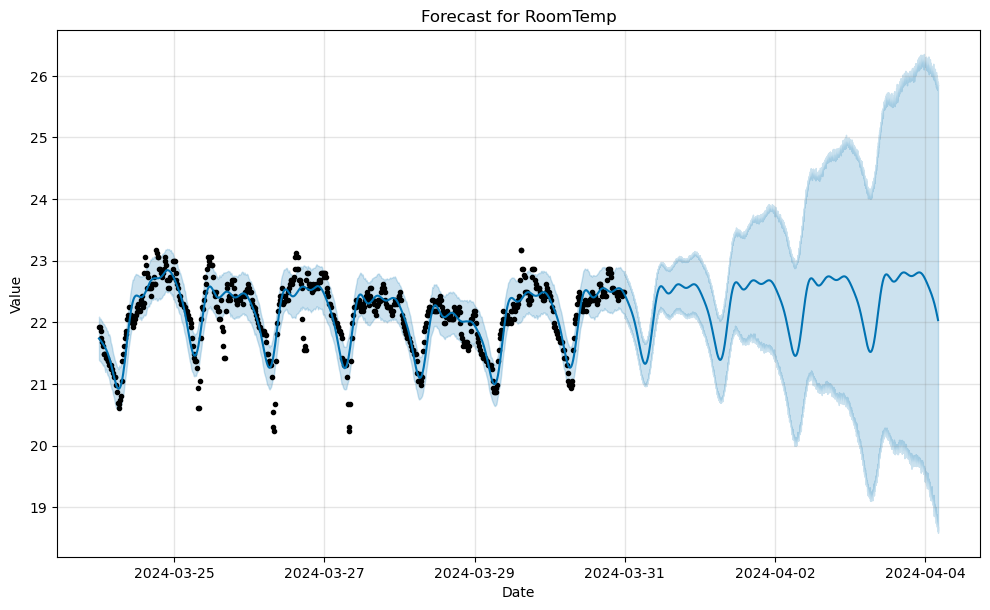

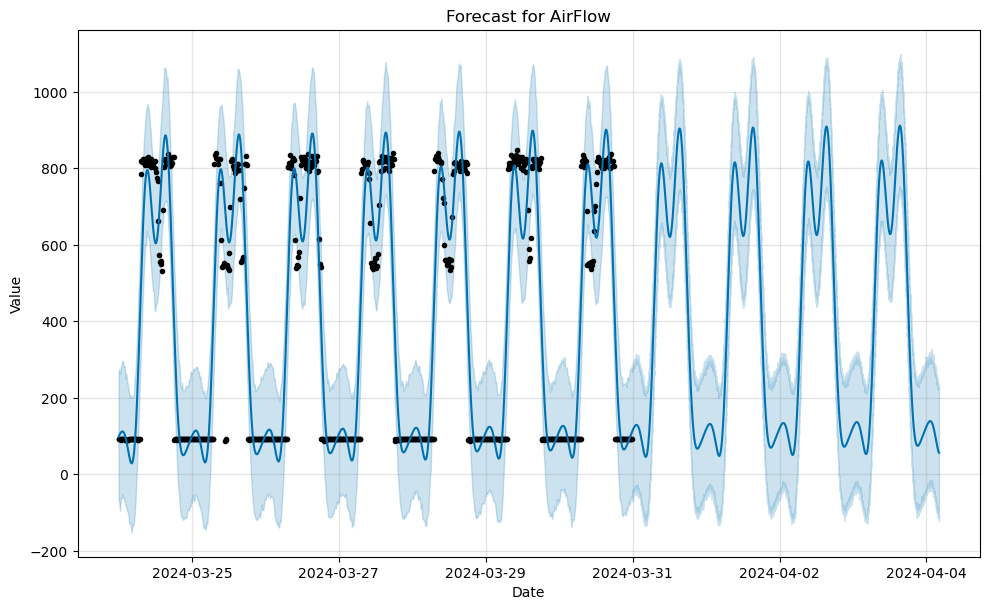

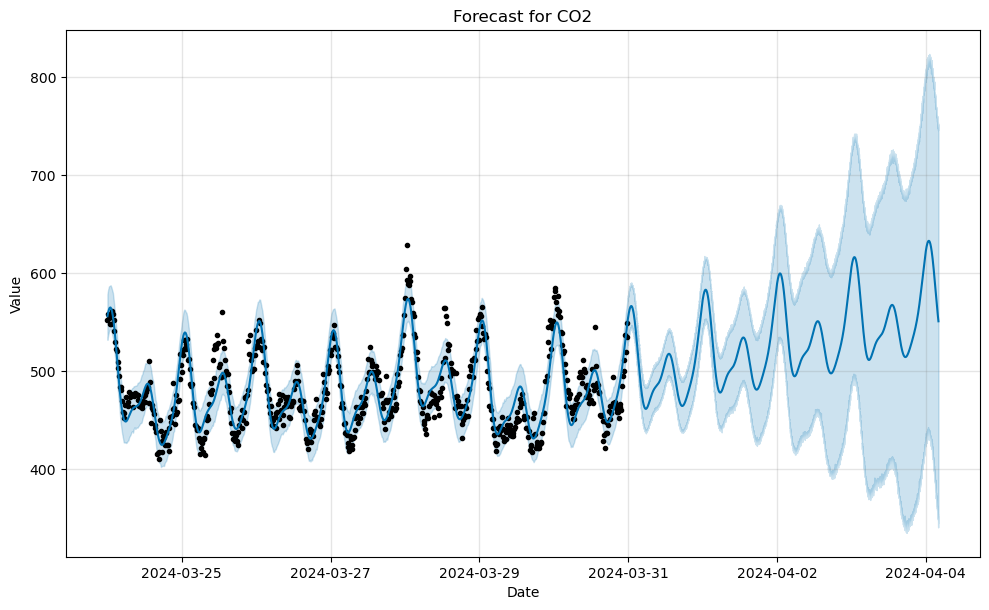

In [14]:
# Plot forecasts for each column separately
for col in ['RoomTemp', 'AirFlow', 'CO2']:
    fig = models[col].plot(forecasts[col])
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Forecast for {col}')
    plt.show()


In [15]:
# Python
from prophet.plot import plot_plotly, plot_components_plotly
 # Plot forecasts for each column separately
for col in ['RoomTemp', 'AirFlow', 'CO2']:
    fig = plot_plotly(models[col], forecast) #forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
    fig.update_layout(title=f'Forecast for {col}')
    fig.show()
   

In [16]:
# Plot components for each column separately
for col in ['RoomTemp', 'AirFlow', 'CO2']:
    fig = plot_components_plotly(models[col], forecast)
    fig.update_layout(title=f'Components for {col}')
    fig.show()


In [23]:
# Calculate correlation matrix
correlation_matrix = df2[['RoomTemp', 'AirFlow', 'CO2']].corr()

# Create heatmap using plotly
heatmap = go.Figure(data=go.Heatmap(
                   z=correlation_matrix.values,
                   x=correlation_matrix.columns,
                   y=correlation_matrix.columns,
                   colorscale='Viridis'))

heatmap.update_layout(
    title='Correlation Heatmap',
    xaxis=dict(title='Columns'),
    yaxis=dict(title='Columns'))

heatmap.show()

## Group 4

In [17]:
# Python
df3 = pd.read_csv('C:/Users/thoma/OneDrive - BCIT/Hackathon Kick-Off!/Question 3_ Building Efficiency and Health/Sensor Readings/Group 4 RT.csv')
df3 = df3.rename(columns={'ITBFC3037_1_RT_TL': 'Room_Temperature'})  # Rename columns
df3.head()

,Timestamp,Room_Temperature
0,2024-03-24 00:01:00,22.920933
1,2024-03-24 00:06:00,22.920933
2,2024-03-24 00:11:00,22.920933
3,2024-03-24 00:16:00,22.920933
4,2024-03-24 00:21:00,22.824791


In [18]:
# Prepare DataFrame for Prophet
df3['ds'] = pd.to_datetime(df3['Timestamp'])  # Assuming 'Timestamp' is the column containing timestamps
# Combine non-null values of the current column into a single column 'y'
df3['y'] = df3['Room_Temperature']  # For Prophet, each column to analyze should be named 'y'

# Drop rows with NaN values in the current column
df3.dropna(subset=['y'], inplace=True)

# Split data into training and testing sets
train_df3, test_df3 = train_test_split(df3, test_size=0.2, shuffle=False)


In [19]:

# Initialize variables to store the best model and its RMSE
best_model3 = None
best_rmse = np.inf

for _ in range(10):  # Repeat the process 10 times to reduce randomness
    # Initialize Prophet model
    model = Prophet()

    # Fit the model to the training data
    model.fit(train_df3)

    # Make predictions on the testing data
    future = model.make_future_dataframe(periods=len(test_df3), freq='min')  # Adjust frequency as needed
    # future = model.make_future_dataframe(periods=1, freq='H')  # hourly
    # future = model.make_future_dataframe(periods=15, freq='min')  # 15 minutes
    # future = model.make_future_dataframe(periods=365)  # Daily
    
    forecast = model.predict(future)

    # Compute RMSE
    y_true = test_df3['y'].values
    y_pred = forecast['yhat'].iloc[-len(test_df3):].values
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))

    # Update best model and RMSE if necessary
    if rmse < best_rmse:
        best_model3 = model
        best_rmse = rmse

# Print the best RMSE
print("Best RMSE:", best_rmse)

future.tail()

00:00:22 - cmdstanpy - INFO - Chain [1] start processing
00:00:23 - cmdstanpy - INFO - Chain [1] done processing
00:00:24 - cmdstanpy - INFO - Chain [1] start processing
00:00:26 - cmdstanpy - INFO - Chain [1] done processing
00:00:27 - cmdstanpy - INFO - Chain [1] start processing
00:00:29 - cmdstanpy - INFO - Chain [1] done processing
00:00:31 - cmdstanpy - INFO - Chain [1] start processing
00:00:33 - cmdstanpy - INFO - Chain [1] done processing
00:00:35 - cmdstanpy - INFO - Chain [1] start processing
00:00:36 - cmdstanpy - INFO - Chain [1] done processing
00:00:38 - cmdstanpy - INFO - Chain [1] start processing
00:00:39 - cmdstanpy - INFO - Chain [1] done processing
00:00:41 - cmdstanpy - INFO - Chain [1] start processing
00:00:43 - cmdstanpy - INFO - Chain [1] done processing
00:00:44 - cmdstanpy - INFO - Chain [1] start processing
00:00:46 - cmdstanpy - INFO - Chain [1] done processing
00:00:48 - cmdstanpy - INFO - Chain [1] start processing
00:00:49 - cmdstanpy - INFO - Chain [1]

Best RMSE: 0.40260283320926654


,ds
2011,2024-03-29 20:55:00
2012,2024-03-29 20:56:00
2013,2024-03-29 20:57:00
2014,2024-03-29 20:58:00
2015,2024-03-29 20:59:00


In [20]:
# Make predictions
forecast = best_model3.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
2011,2024-03-29 20:55:00,23.052009,22.780814,23.313177
2012,2024-03-29 20:56:00,23.052012,22.792910,23.301870
2013,2024-03-29 20:57:00,23.052002,22.781318,23.305261
2014,2024-03-29 20:58:00,23.051981,22.774597,23.295761
2015,2024-03-29 20:59:00,23.051946,22.778106,23.312936


In [21]:
from prophet.plot import plot_plotly, plot_components_plotly

plot_plotly(best_model3, forecast)


In [22]:
plot_components_plotly(best_model, forecast)